<a href="https://colab.research.google.com/github/Lelytameyda29rpl/PCVK_Ganjil_2025/blob/main/Week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Langkah 2 - Akses folder gambar di Google Drive

In [4]:
from google.colab import drive  # Mengimpor modul 'drive' dari pustaka 'google.colab'
                                 # untuk mengakses Google Drive di Google Colab.

drive.mount('/content/drive')   # Memasang (mount) Google Drive ke direktori '/content/drive'
                                 # sehingga file di Google Drive bisa diakses seperti file lokal.


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Langkah 3 - Melakukan transformasi linear kecerahan dengan memasukkan nilai konstan tertentu dan menghasilkan warna

 Mengubah tingkat kecerahan citra 
----------------------------------
Masukkan nilai kecerahan: 50


/tmp/ipython-input-2082385788.py:24: RuntimeWarning: overflow encountered in scalar add
  brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)


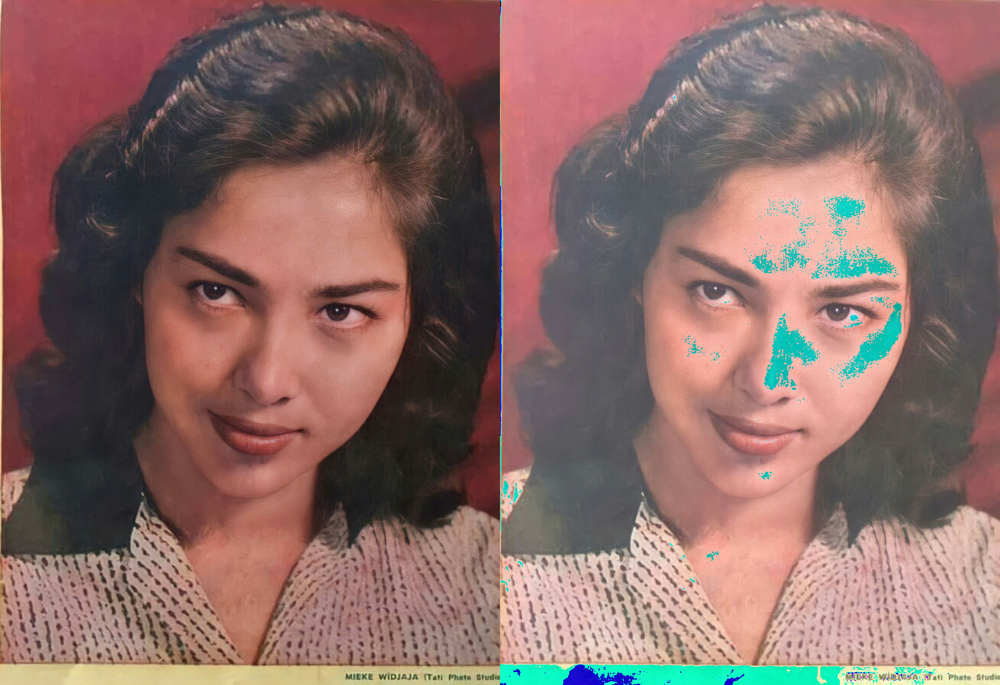

In [5]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

print(' Mengubah tingkat kecerahan citra ')
print('----------------------------------')

try:
    brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
    print('Error, not a number')
    brightness = 0  # default

# Baca citra asli
original = cv.imread('/content/drive/MyDrive/images/female.jpg')

# Membuat array kosong dengan ukuran dan tipe data sama
brightness_image = np.zeros(original.shape, original.dtype)

# Mengubah kecerahan per piksel
for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        for c in range(original.shape[2]):
            brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

# Alternatif cara cepat:
# brightness_image = cv.convertScaleAbs(original, beta=brightness)

# Menggabungkan citra asli dan citra hasil
final_frame = cv.hconcat([original, brightness_image])

# Tampilkan di Colab
cv2_imshow(final_frame)

# TUGAS

1. Terapkan invers gambar dalam kode Anda menggunakan rumus yang ditunjukkan pada subbagian latar belakang teoritis di atas, yang menghasilkan output seperti yang ditunjukkan pada gambar.

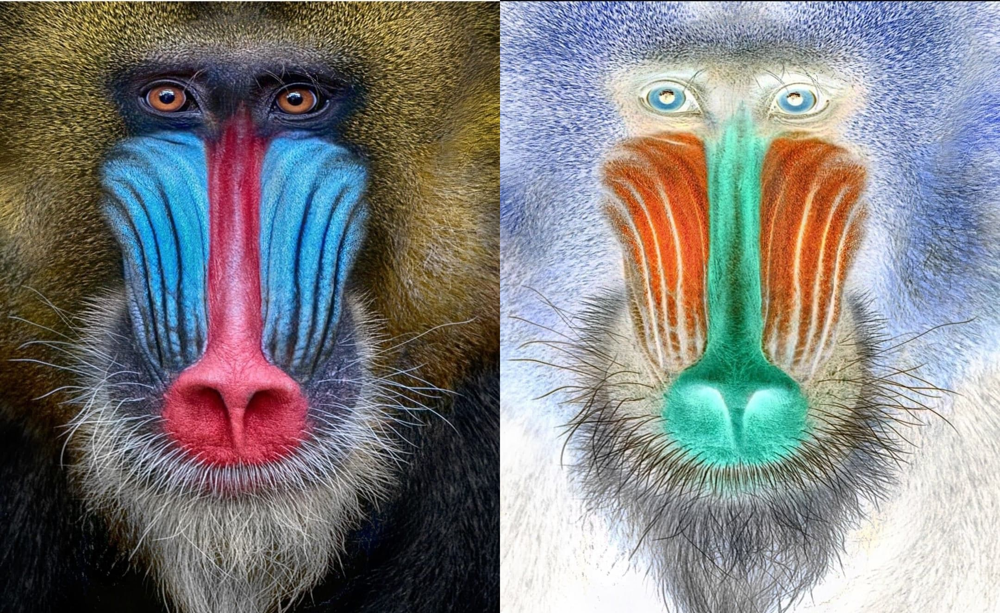

In [8]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# --- Membaca gambar dari Google Drive ---
# from google.colab import drive
# drive.mount('/content/drive')

# Ganti path ini sesuai lokasi file gambar
img = cv.imread('/content/drive/MyDrive/images/mandrill.jpg')

# Pastikan gambar terbaca
if img is None:
    print("Gambar tidak ditemukan, periksa path file-nya.")
else:
    # --- Invers (negatif) citra ---
    inverse_img = 255 - img

    # --- Gabungkan gambar asli dan hasil invers ---
    hasil = cv.hconcat([img, inverse_img])

    # --- Tampilkan hasil ---
    cv2_imshow(hasil)

**Penjelasan**

Kode menerapkan Transformasi Invers (Image Negative) pada sebuah gambar, sesuai rumus dari modul.


- f(x,y) = nilai piksel asli

- g(x,y) = nilai piksel hasil invers

- 255 adalah nilai maksimum piksel 8-bit

Jadi setiap piksel dengan nilai tinggi akan menjadi rendah, dan sebaliknya:

- Piksel gelap (nilai kecil) → menjadi terang

- Piksel terang (nilai besar) → menjadi gelap

- Warna akan berlawanan (komplementer) dari warna asli

**Hasil yang Ditampilkan**

- Gambar kiri: gambar asli mandrill.jpg

- Gambar kanan: gambar negatif/invers dari gambar asli

- Area merah → menjadi cyan kebiruan

- Area biru → menjadi kekuningan

- Area terang → jadi gelap

- Area gelap → jadi terang

Sehingga bisa melihat kontras warna terbalik antara gambar asli dan hasil invers-nya secara berdampingan.

2. Implementasikan transformasi kontras di Google Collaboratory menggunakan rumus yang tertulis di bagian Latar Belakang Teoritis, dan berikan output yang ditunjukkan pada gambar.

Mengubah kontras dan tingkat kecerahan citra
--------------------------------------------
Masukkan tingkat kecerahan [-255 - 255]: 60
Masukkan kontras [1.0 - 3.0]: 1.5


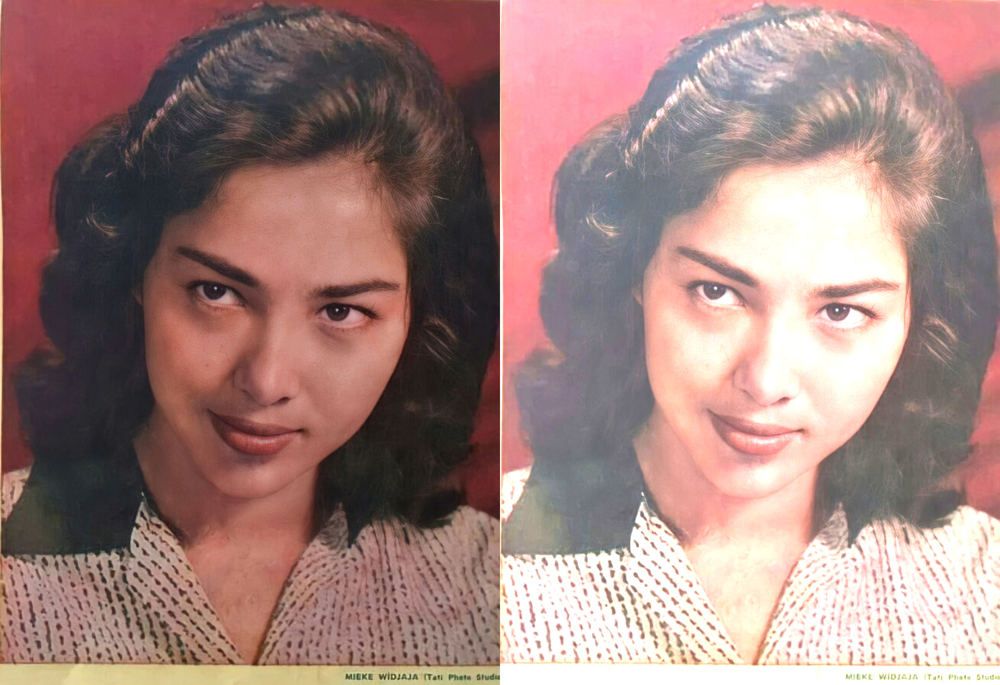

In [10]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# --- Membaca gambar ---
img = cv.imread('/content/drive/MyDrive/images/female.jpg')

if img is None:
    print("Gambar tidak ditemukan, periksa path file-nya.")
else:
    print("Mengubah kontras dan tingkat kecerahan citra")
    print("--------------------------------------------")

    # Input nilai brightness dan kontras
    try:
        brightness = int(input("Masukkan tingkat kecerahan [-255 - 255]: "))
    except:
        brightness = 0

    try:
        contrast = float(input("Masukkan kontras [1.0 - 3.0]: "))
    except:
        contrast = 1.0

    # Ubah ke float agar aman dalam perhitungan
    img_float = img.astype(np.float32)

    # Terapkan transformasi: g(x,y) = contrast * f(x,y) + brightness
    adjusted = contrast * img_float + brightness

    # Pastikan hasil tetap di rentang 0-255
    adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)

    # Gabungkan gambar asli dan hasil secara horizontal
    hasil = cv.hconcat([img, adjusted])

    # Tampilkan hasil
    cv2_imshow(hasil)

**Penjelasan**

Menggunakan persamaan linear brightness + contrast

- f(x,y) → nilai piksel asli (0–255)

- contrast → faktor pengali kontras (misal 1.5 memperkuat perbedaan terang-gelap)

- brightness → nilai penambah kecerahan (misal 60 menambah intensitas semua piksel)

- g(x,y) → nilai piksel baru setelah disesuaikan

**Hasil yang Ditampilkan**

- Gambar kiri → gambar asli female.jpg

- Gambar kanan → hasil setelah diubah kontras & brightness:

  - Jika brightness positif → seluruh gambar tampak lebih terang.

  - Jika brightness negatif → seluruh gambar tampak lebih gelap.

- Jika contrast > 1 → bagian terang jadi makin terang, bagian gelap makin gelap (kontras meningkat).

- Jika contrast < 1 → perbedaan terang-gelap mengecil (gambar tampak datar/pucat).

Sehingga bisa langsung membandingkan sebelum dan sesudah pengaturan brightness & contrast.

3. Implementasikan transformasi kecerahan logaritmik pada Google Colaboratory menggunakan rumus yang tertulis dalam Tinjauan Latar Belakang Teoritis, menghasilkan keluaran yang ditunjukkan pada gambar.

Mengubah tingkat kecerahan citra dengan Transformasi Log
----------------------------------------------------------
Masukkan nilai kecerahan: 40


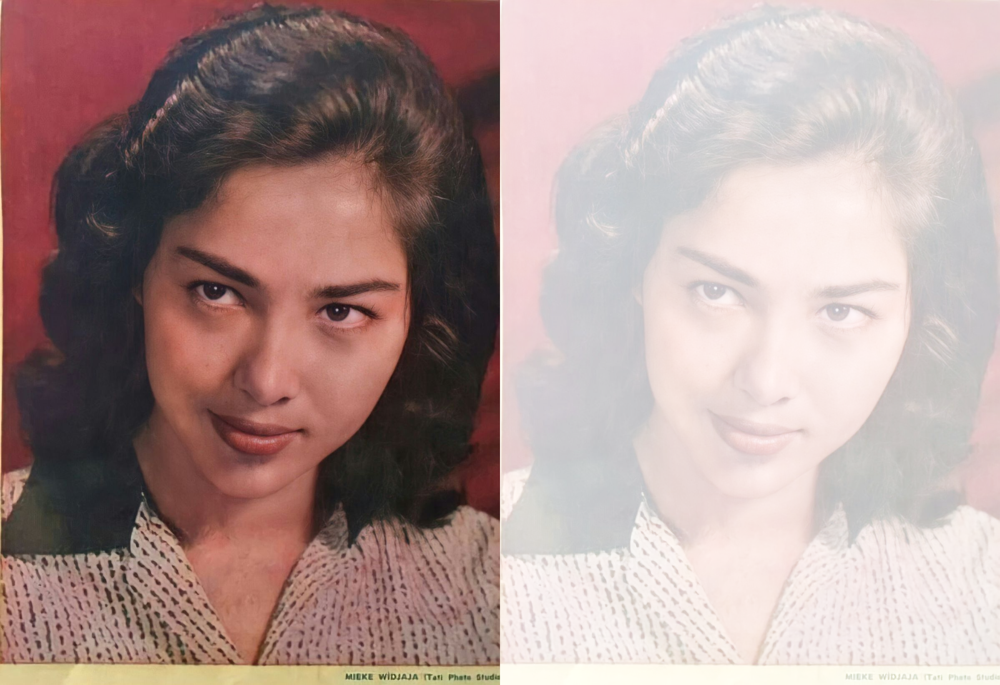

In [12]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# --- Membaca gambar ---
img = cv.imread('/content/drive/MyDrive/images/female.jpg')

if img is None:
    print("Gambar tidak ditemukan, periksa path file-nya.")
else:
    print("Mengubah tingkat kecerahan citra dengan Transformasi Log")
    print("----------------------------------------------------------")

    # Input brightness dari user
    try:
        b = int(input("Masukkan nilai kecerahan: "))
    except:
        b = 0

    # Ubah ke float agar tidak overflow
    img_float = img.astype(np.float32)

    # Tambahkan nilai brightness ke setiap piksel
    img_bright = np.clip(img_float + b, 0, 255)

    # Hitung nilai c
    c = 255 / np.log(1 + np.max(img_bright))

    # Terapkan log transform
    log_img = c * np.log(1 + img_bright)

    # Konversi kembali ke uint8
    log_img = np.clip(log_img, 0, 255).astype(np.uint8)

    # Gabungkan gambar asli dan hasil
    hasil = cv.hconcat([img, log_img])

    # Tampilkan hasil
    cv2_imshow(hasil)

**Penjelasan**

Transformasi logaritmik digunakan untuk:

- Mencerahkan area gelap agar detailnya terlihat

- Menekan area terang agar tidak terlalu mencolok

**Hasil yang Ditampilkan**

- Gambar kiri → gambar asli female.jpg

- Gambar kanan → hasil setelah transformasi log brightness

Efek visual yang akan terlihat:

- Area gelap menjadi lebih terang dan detail terlihat jelas

- Area terang tidak terlalu bertambah terang (karena log menekan nilai tinggi)

- Hasil tampak seperti gambar dipaparkan cahaya lembut, tidak overexposure

Jika menambah nilai b, maka seluruh gambar akan menjadi lebih terang sebelum diaplikasikan log, sehingga efek pencerahan jadi makin kuat.

4. Implementasikan transformasi skala abu-abu menggunakan metode rata-rata, kecerahan, dan luminansi di Google Colaboratory menggunakan rumus yang tertulis dalam Tinjauan Latar Belakang Teoritis, menghasilkan keluaran sebagai berikut:

   a. Averaging

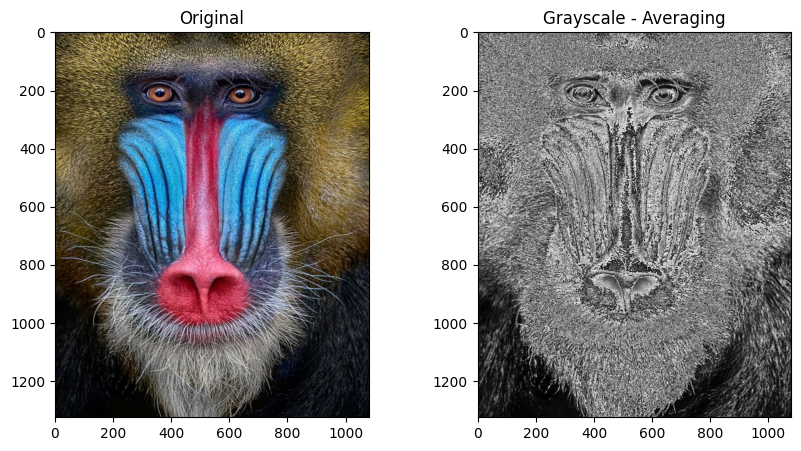

In [14]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Baca gambar
img = cv.imread('/content/drive/MyDrive/images/mandrill.jpg')

if img is None:
    print("Gambar tidak ditemukan")
else:
    # Konversi BGR (OpenCV) ke RGB (matplotlib)
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    # Hitung grayscale averaging: (R+G+B)/3
    R = img_rgb[:,:,0]
    G = img_rgb[:,:,1]
    B = img_rgb[:,:,2]
    gray_avg = ((R + G + B) / 3).astype(np.uint8)

    # Tampilkan hasil berdampingan
    plt.figure(figsize=(10,5))

    # Gambar asli
    plt.subplot(1,2,1)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('on')

    # Grayscale averaging
    plt.subplot(1,2,2)
    plt.imshow(gray_avg, cmap='gray')
    plt.title('Grayscale - Averaging')
    plt.axis('on')

    plt.show()

**Penjelasan**

Tujuan dari metode averaging adalah mengubah citra berwarna (RGB) menjadi citra grayscale dengan cara merata-ratakan ketiga kanal warna.

**Hasil yang Ditampilkan**

- Kiri: Gambar mandrill.jpg berwarna penuh (RGB)

- Kanan: Gambar grayscale hasil perhitungan rata-rata

Ciri khas hasil grayscale averaging:

- Tidak ada warna sama sekali, hanya tingkat abu-abu

- Area yang awalnya terang akan tetap terang dalam abu-abu

- Area yang awalnya gelap akan tetap gelap dalam abu-abu

- Semua warna diubah ke intensitas yang sebanding dengan kecerahan rata-rata warna aslinya

b. Lightness

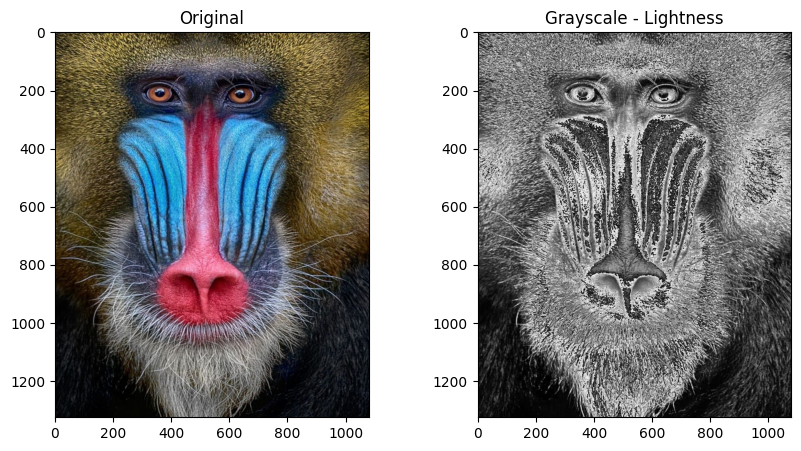

In [15]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Baca gambar
img = cv.imread('/content/drive/MyDrive/images/mandrill.jpg')

if img is None:
    print("Gambar tidak ditemukan")
else:
    # Konversi ke RGB untuk tampil di matplotlib
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    # Rumus lightness: (max(R,G,B) + min(R,G,B)) / 2
    max_rgb = np.max(img_rgb, axis=2)
    min_rgb = np.min(img_rgb, axis=2)
    gray_light = ((max_rgb + min_rgb) / 2).astype(np.uint8)

    # Tampilkan hasil berdampingan
    plt.figure(figsize=(10,5))

    # Gambar asli
    plt.subplot(1,2,1)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('on')

    # Grayscale lightness
    plt.subplot(1,2,2)
    plt.imshow(gray_light, cmap='gray')
    plt.title('Grayscale - Lightness')
    plt.axis('on')

    plt.show()

**Penjelasan**

Tujuan dari metode lightness adalah memberikan nilai keabuan berdasarkan rentang kecerahan warna piksel, bukan berdasarkan rata-rata semua warna.

**Hasil yang Ditampilkan**

- Kiri → Gambar asli mandrill.jpg berwarna penuh

- Kanan → Gambar grayscale hasil metode lightness

**Ciri hasil:**

- Warna dihilangkan, hanya sisa tingkat abu-abu

- Karena hanya memakai nilai maksimum dan minimum, hasilnya lebih kontras dibanding metode averaging

- Piksel dengan warna yang memiliki perbedaan besar antar kanal akan tampak lebih terang/gelap secara ekstrem

c. Luminace

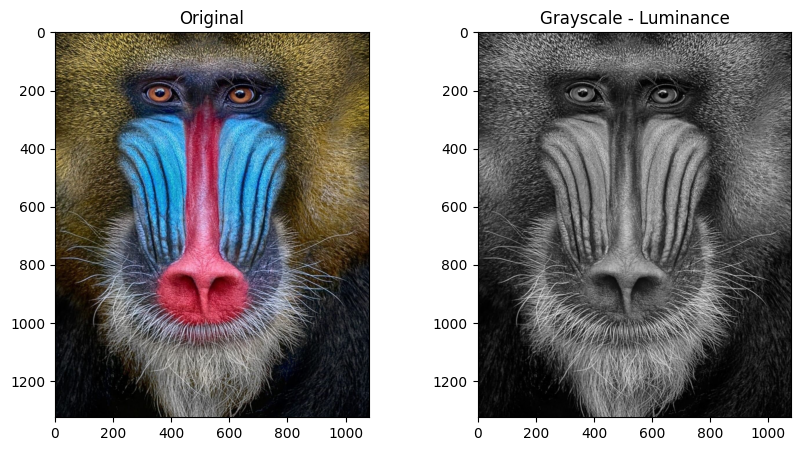

In [16]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Baca gambar
img = cv.imread('/content/drive/MyDrive/images/mandrill.jpg')

if img is None:
    print("Gambar tidak ditemukan")
else:
    # Konversi ke RGB untuk tampil di matplotlib
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    # Pisahkan channel R, G, B
    R = img_rgb[:,:,0].astype(np.float32)
    G = img_rgb[:,:,1].astype(np.float32)
    B = img_rgb[:,:,2].astype(np.float32)

    # Rumus luminance: 0.21*R + 0.72*G + 0.07*B
    gray_lum = (0.21*R + 0.72*G + 0.07*B).astype(np.uint8)

    # Tampilkan hasil berdampingan
    plt.figure(figsize=(10,5))

    # Gambar asli
    plt.subplot(1,2,1)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('on')

    # Grayscale luminance
    plt.subplot(1,2,2)
    plt.imshow(gray_lum, cmap='gray')
    plt.title('Grayscale - Luminance')
    plt.axis('on')

    plt.show()

**Penjelasan**

Metode luminance mengubah citra berwarna menjadi grayscale dengan memberi bobot berbeda pada setiap kanal warna, sesuai sensitivitas mata manusia.

- Mata manusia paling sensitif pada hijau, cukup sensitif pada merah, dan paling tidak sensitif pada biru

- Karena itu nilai G (hijau) diberi bobot paling besar → 0.72

Metode ini dianggap paling natural dan akurat secara persepsi manusia dibanding Averaging dan Lightness.

**Hasil yang Ditampilkan**

Kiri → Gambar asli mandrill.jpg berwarna penuh

Kanan → Gambar grayscale hasil metode luminance

**Ciri khas hasil:**

- Warna hilang → hanya abu-abu

- Area yang dominan hijau tampak lebih terang (karena bobot 0.72)

- Area biru terlihat lebih gelap (karena bobot hanya 0.07)

- Hasil tampak paling realistis dan natural, mendekati persepsi mata manusia terhadap kecerahan

5. ampilkan warna-warna tertentu dalam gambar, dan ubah warna lainnya menjadi skala abu-abu (grayscale). Contohnya, tampilkan warna biru pada gambar masukan dan ubah bagian lain yang tidak berwarna biru menjadi skala abu-abu seperti contoh

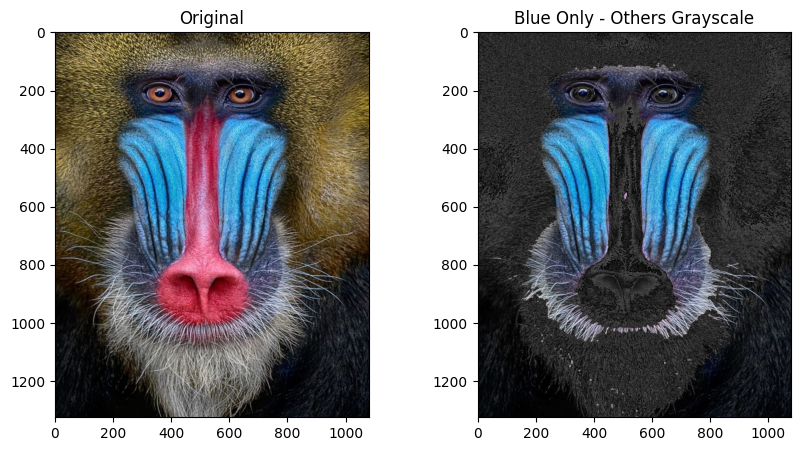

In [17]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Baca gambar
img = cv.imread('/content/drive/MyDrive/images/mandrill.jpg')

if img is None:
    print("Gambar tidak ditemukan")
else:
    # Konversi ke RGB agar sesuai matplotlib
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    # Pisahkan channel
    R = img_rgb[:,:,0]
    G = img_rgb[:,:,1]
    B = img_rgb[:,:,2]

    # Buat grayscale dari averaging (atau bisa luminance)
    gray = ((R + G + B) / 3).astype(np.uint8)
    gray_3ch = cv.cvtColor(gray, cv.COLOR_GRAY2RGB)

    # Buat masker area biru (jika nilai B lebih besar dari R dan G)
    mask_biru = (B > R) & (B > G)

    # Buat hasil akhir: jika biru → warna asli, kalau tidak → grayscale
    hasil = gray_3ch.copy()
    hasil[mask_biru] = img_rgb[mask_biru]

    # Tampilkan hasil berdampingan
    plt.figure(figsize=(10,5))

    # Gambar asli
    plt.subplot(1,2,1)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('on')

    # Gambar hasil transformasi custom color (biru)
    plt.subplot(1,2,2)
    plt.imshow(hasil)
    plt.title('Blue Only - Others Grayscale')
    plt.axis('on')

    plt.show()

**Penjelasan**

**Tujuan dari kode ini:**

- Menampilkan hanya bagian gambar yang berwarna biru secara asli

- Mengubah seluruh bagian lain menjadi grayscale

**Langkah logika utamanya:**

- Hitung grayscale dari gambar berwarna

- Buat masker piksel biru → bagian yang nilai B (blue) > R dan B > G

- Buat gambar baru berisi grayscale semua piksel

- Ganti area yang termasuk masker biru menjadi warna asli

**Hasil yang Ditampilkan**

- Gambar kiri → gambar mandrill.jpg berwarna penuh

- Gambar kanan → gambar campuran:

  - Area berwarna biru → tetap tampil berwarna asli

  - Area selain biru → berubah menjadi grayscale (abu-abu)

- Efek ini disebut color splash / color isolation — teknik untuk menonjolkan satu warna dan menonaktifkan warna lain.